# Trabajo Práctico 1 - Visión por Computadora III
Alumna: Trinidad Monreal

## Vision Transformer (ViT)

El **Vision Transformer (ViT)** es un modelo innovador para la clasificación de imágenes que transforma las imágenes en secuencias de parches más pequeños, comúnmente de $16 \times 16$ píxeles, como se describe en el paper de [Alexey Dosovitskiy et al.](https://openreview.net/pdf?id=YicbFdNTTy)  "An Image is Worth 16x16 Words: Transformers for Image Recognition at Scale". Cada parche se considera como una "palabra" o "token" y se proyecta en un espacio de características. Mediante la incorporación de cifrados de posición y un token de clasificación, podemos aplicar un Transformer de manera convencional a esta secuencia, permitiendo su entrenamiento para tareas de clasificación de imágenes.

## Embeddings y Cifrado de Posición

### Embeddings
En el contexto de ViTs, las imágenes son primero divididas en pequeños bloques o patches (como si se cortaran en pequeños cuadrados). Estos patches se tratan como si fueran palabras en un modelo de lenguaje, y a cada uno se le asigna un embedding. Un embedding es simplemente una representación numérica del patch en un espacio de alta dimensión que captura características relevantes del mismo.

Por ejemplo, si divides una imagen de 224x224 píxeles en 16x16 bloques, tendrás 196 patches en total. Cada uno de esos patches se convierte en un vector de embedding, que luego se alimenta al modelo Transformer.

### Positional Embedding (Cifrado Posicional):

El **embedding posicional** agrega información sobre la ubicación de cada parche en la imagen original. En el paper de Alexey Dosovitskiy et al., se evaluaron varias formas de codificar la información espacial con embebidos posicionales. Se observó que, aunque el uso de embebidos mejora el rendimiento en comparación con no usarlos, no hay diferencias significativas entre los métodos probados. Se concluyó que, dado que el modelo opera a nivel de parches en lugar de píxeles, la forma específica de codificar la posición es menos relevante.
## Proceso de Creación de Embeddings

1. **División en Parches**: La imagen se divide en parches de $N \times N$ píxeles.
   
2. **Generación de Embeddings**: Cada parche se transforma en un embedding que captura su información relevante.

3. **Cifrado de Posición**: Se añade un vector de cifrado de posición a cada embedding. 

   Algunos ejemplos del cifrado:


   *  **Codificación Sinusoidal:** La fórmula sinusoidal para embebidos posicionales (tradicional en Transformers-NLP) genera los valores de los embebidos en función de senos y cosenos. Estos valores dependen directamente de la posición y siguen una periodicidad específica para capturar relaciones posicionales. Es determinista y no se ajusta durante el entrenamiento, ya que los valores están calculados y fijos para cada posición.
   Donde:
       - $pos$ es la posición en la secuencia.
       - $i$ es el índice de la dimensión.
       - $d_{model}$ es la dimensión del modelo.

   $$PE(pos, 2i) = \sin\left(\frac{pos}{10000^{\frac{2i}{d_{model}}}}\right)$$

   $$PE(pos, 2i + 1) = \cos\left(\frac{pos}{10000^{\frac{2i}{d_{model}}}}\right)$$



   * **Embebido Posicional Aprendido (a ser implementada por el alumno):** los embebidos posicionales se definen como un parámetro de la red neuronal (usando [nn.Parameter](https://pytorch.org/docs/stable/generated/torch.nn.parameter.Parameter.html)), lo que significa que los valores para el embebido  posicional se aprenden durante el proceso de entrenamiento. Se define embedding, matriz de tamaño (1, num_patches, embed_dim), donde num_patches es el número de parches (posiciones) en la secuencia de la imagen y  embed_dim es la dimensión de los embebidos. La inicialización torch.randn genera valores aleatorios para estos embebidos posicionales, y luego el modelo los optimiza durante el entrenamiento, ajustando los valores en función de los gradientes.

4. **Combinación de Embeddings y Cifrado de Posición**: Se suma cada embedding con su correspondiente cifrado de posición, generando un vector final que contiene tanto la información del contenido del parche como su posición en la imagen.

El resultado es una serie de vectores, cada uno representando un parche y su posición, que se alimentan a las capas del Transformer. Esto permite al modelo aprender no solo sobre las características individuales de cada parche, sino también sobre cómo estos se relacionan entre sí en el contexto de la imagen completa.


![Vision Transformer](/home/tmonreal/Desktop/Vision_Transformers/vision-transformers/TP1/vit.gif)

*Crédito: [Phil Wang](https://github.com/lucidrains/vit-pytorch/blob/main/images/vit.gif)*


A continuación, trabajaremos con los **patch embeddings** y la **codificación posicional**, esenciales para que el modelo pueda interpretar las relaciones espaciales en las imágenes. 

## Tareas:

1. **Modificar los parametros:** Cambiar el tamaño de los parches, y la cantidad de dimensiones del embedding. Investigar y describir las ventajas y desventajas de tener más o menos parches/dimensiones.

2. **Implementar embedding posicional aprendido 1D:** Partiendo de ejemplo proporcionado (codificación sinusoidal en clase PositionalEncoding), implementar una clase PositionalEncodingLearned que utilice PyTorch y genere embebidos posicionales aprendidos. Graficar. 


In [1]:
import torch
from torch import Tensor
import torch.nn as nn
import torchvision.transforms.functional as TF
import matplotlib.pyplot as plt
from PIL import Image
import math

Dispositivo utilizado: cpu


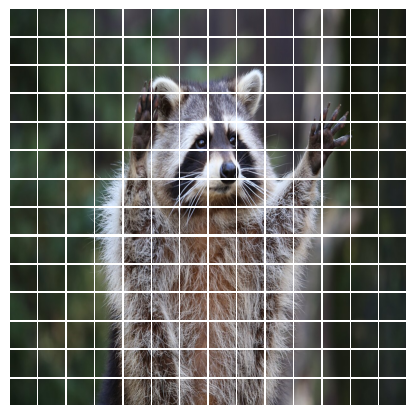

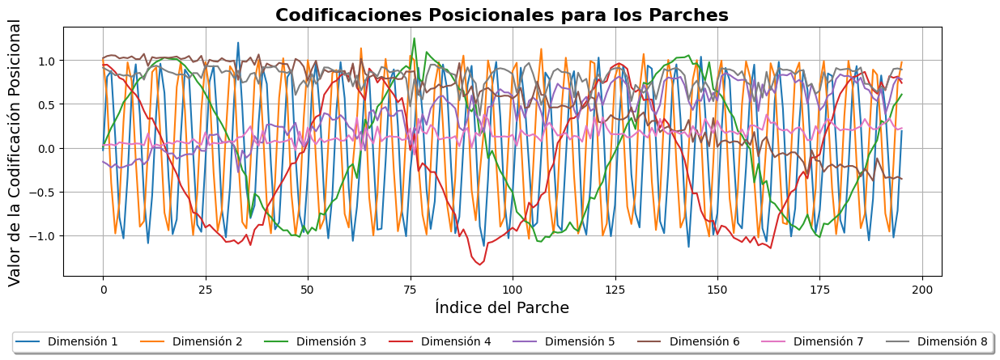

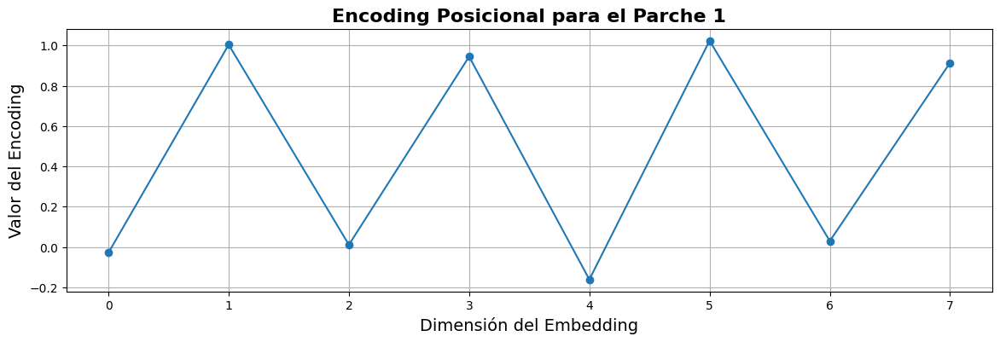

In [6]:
# La configuración, carga y preprocesamiento
class ConfigPreprocess:
    def __init__(self, img_path: str, img_size: int, patch_size: int):
        self.device = 'cuda' if torch.cuda.is_available() else 'mps' if torch.backends.mps.is_available() else 'cpu'
        print(f'Dispositivo utilizado: {self.device}')
        
        self.img_path = img_path
        self.img_size = img_size
        self.patch_size = patch_size
        self.test_img = self.load_image()

    def load_image(self):
        return TF.to_tensor(Image.open(self.img_path).resize((self.img_size, self.img_size))).unsqueeze(0).to(self.device)

    def extract_patches(self, image: Tensor) -> Tensor:
        patches = image.unfold(1, self.patch_size, self.patch_size).unfold(2, self.patch_size, self.patch_size)
        patches = patches.contiguous().view(image.shape[0], -1, self.patch_size, self.patch_size)
        return patches
    

class PatchEmbedding(nn.Module):
    def __init__(self, img_size: int, patch_size: int, in_channels: int = 3, embed_dim: int = 8):
        super(PatchEmbedding, self).__init__()
        self.img_size = img_size
        self.patch_size = patch_size
        self.num_patches = (img_size // patch_size) ** 2
        self.proj = nn.Conv2d(in_channels, embed_dim, kernel_size=patch_size, stride=patch_size)

    def forward(self, x):
        x = self.proj(x)  # (B, embed_dim, H/patch_size, W/patch_size)
        x = x.flatten(2)  # (B, embed_dim, num_patches)
        x = x.transpose(1, 2)  # (B, num_patches, embed_dim)
        return x

class PositionalEncoding(nn.Module):
    def __init__(self, num_patches, embed_dim):
        super(PositionalEncoding, self).__init__()
        self.register_buffer('pos_embedding', self.create_positional_encoding(num_patches, embed_dim))

    def create_positional_encoding(self, num_patches, embed_dim):
        position = torch.arange(num_patches, dtype=torch.float).unsqueeze(1)
        div_term = torch.exp(torch.arange(0, embed_dim, 2).float() * -(math.log(10000.0) / embed_dim))
        pos_encoding = torch.zeros(num_patches, embed_dim)
        pos_encoding[:, 0::2] = torch.sin(position * div_term)  # Aplicar seno en dimensiones pares
        pos_encoding[:, 1::2] = torch.cos(position * div_term)  # Aplicar coseno en dimensiones impares
        return pos_encoding.unsqueeze(0)  # Añadir dimensión de batch

    def forward(self, x):
        return x + self.pos_embedding

class Visualization:
    @staticmethod  # No requiere self
    def visualize_patches(patches: Tensor):
        num_patches = patches.shape[1]
        num_cols = int(num_patches ** 0.5)
        num_rows = (num_patches + num_cols - 1) // num_cols
        _, axs = plt.subplots(num_rows, num_cols, figsize=(4, 4))
        for i in range(num_rows):
            for j in range(num_cols):
                idx = i * num_cols + j
                if idx < num_patches:
                    patch = patches[:, idx]
                    num_channels = patch.shape[0]
                    if num_channels == 1:
                        axs[i, j].imshow(patch.squeeze().detach().cpu().numpy(), cmap='gray')
                    elif num_channels == 3:
                        axs[i, j].imshow(patch.permute(1, 2, 0).detach().cpu().numpy())
                    axs[i, j].axis('off')
                else:
                    axs[i, j].axis('off')
        plt.tight_layout(pad=0.15)
        plt.show()

    @staticmethod  # No requiere self
    def visualize_positional_encoding(pos_embeddings: Tensor, show_legend=True):
        plt.figure(figsize=(14, 4))
        plt.title('Codificaciones Posicionales para los Parches', fontsize=16, weight='bold')
        for i in range(pos_embeddings.shape[2]):
            plt.plot(pos_embeddings[0, :, i].detach().cpu().numpy(), label=f'Dimensión {i + 1}')
        plt.xlabel('Índice del Parche', fontsize=14)
        plt.ylabel('Valor de la Codificación Posicional', fontsize=14)
        if show_legend:
            plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2),
                   fancybox=True, shadow=True, ncol=8, fontsize=10)
        plt.grid()
        plt.show()

    @staticmethod
    def visualize_single_patch_encoding(pos_embeddings: Tensor, patch_idx: int):
        num_patches = pos_embeddings.shape[1]
        if patch_idx < 0 or patch_idx >= num_patches:
            raise ValueError(f"El índice del parche debe estar entre 0 y {num_patches - 1}, pero se recibió {patch_idx}.")
        patch_encoding = pos_embeddings[0, patch_idx, :].detach().cpu().numpy()
        plt.figure(figsize=(14, 4))
        plt.plot(patch_encoding, marker='o', label=f'Parche {patch_idx + 1}')
        plt.title(f'Encoding Posicional para el Parche {patch_idx + 1}', fontsize=16, weight='bold')
        plt.xlabel('Dimensión del Embedding', fontsize=14)
        plt.ylabel('Valor del Encoding', fontsize=14)
        plt.grid()
        #plt.legend()
        plt.show()

# Parámetros
img_path = "raccoon.jpg"
img_size = 900
patch_size = 64
embed_dim = 8
patch_idx = 0  # El índice del parche para el cual queres visualiizar la codificación posicional

# Preprocesamiento
config = ConfigPreprocess(img_path, img_size, patch_size)

# Extracción de parches y visualización
patches = config.extract_patches(config.test_img.squeeze(0))
Visualization.visualize_patches(patches)

# Generación de embeddings
embedded_patches = PatchEmbedding(img_size, patch_size, 3, embed_dim).to(config.device)
patches = embedded_patches(config.test_img)

# Codificación posicional
num_patches = (img_size // patch_size) ** 2
positional_encoding = PositionalEncoding(num_patches, embed_dim).to(config.device)
pos_embeddings = positional_encoding(patches)
Visualization.visualize_positional_encoding(pos_embeddings)
Visualization.visualize_single_patch_encoding(pos_embeddings, patch_idx)

### **1. Modificar los parametros:** Cambiar el tamaño de los parches, y la cantidad de dimensiones del embedding. Investigar y describir las ventajas y desventajas de tener más o menos parches/dimensiones.

Procesando imagen con patch_size=30 y embed_dim=8
Dispositivo utilizado: cpu


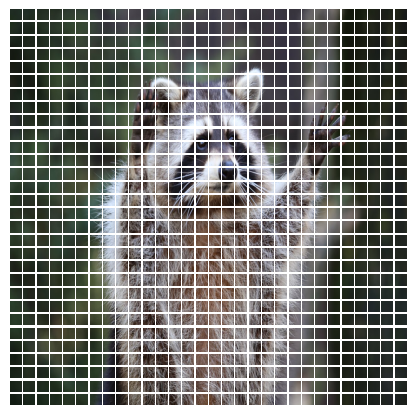

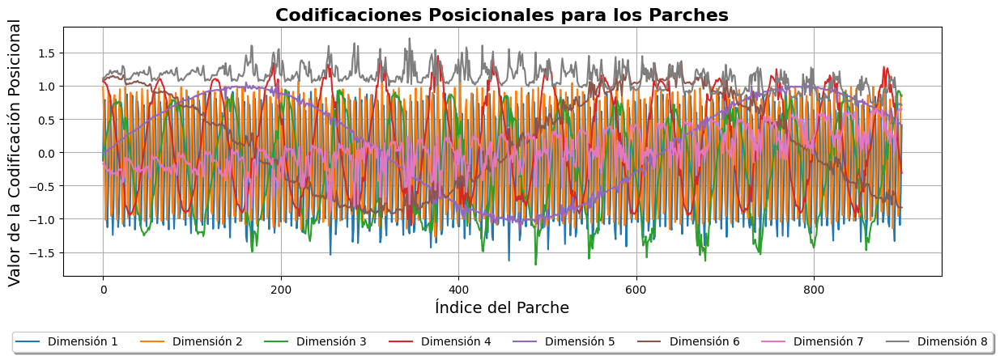

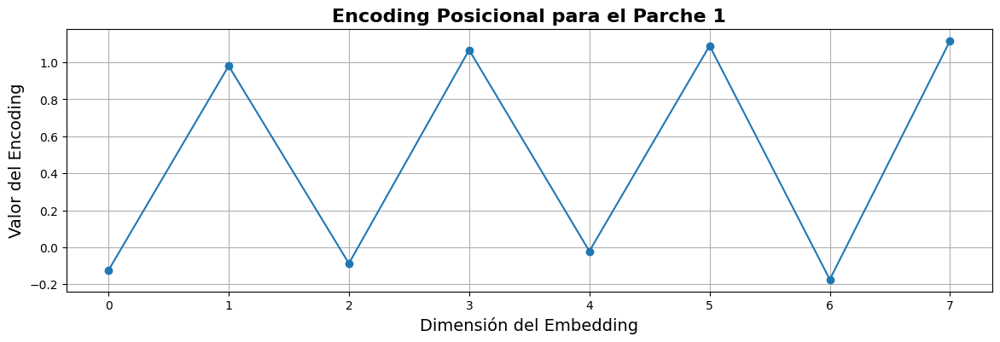

Procesando imagen con patch_size=30 y embed_dim=16
Dispositivo utilizado: cpu


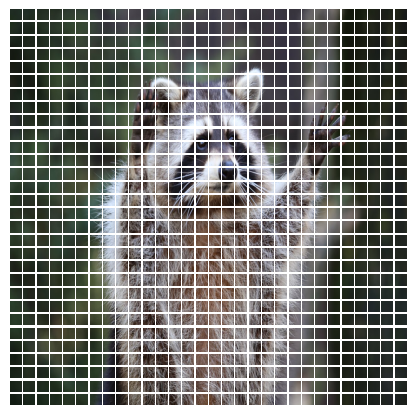

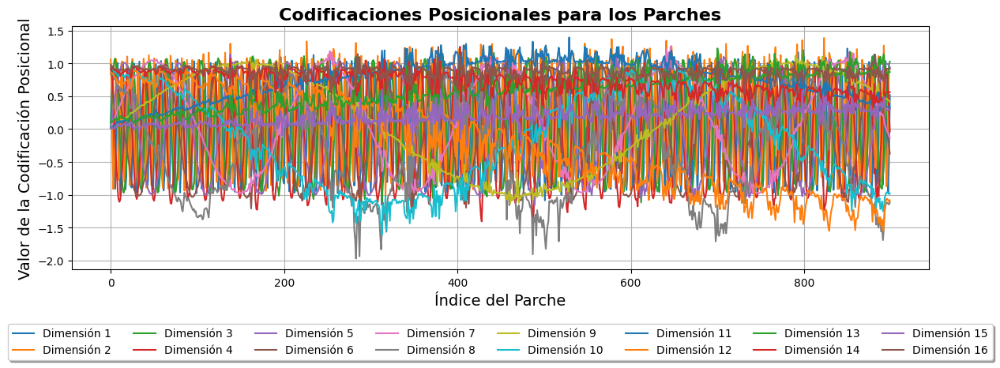

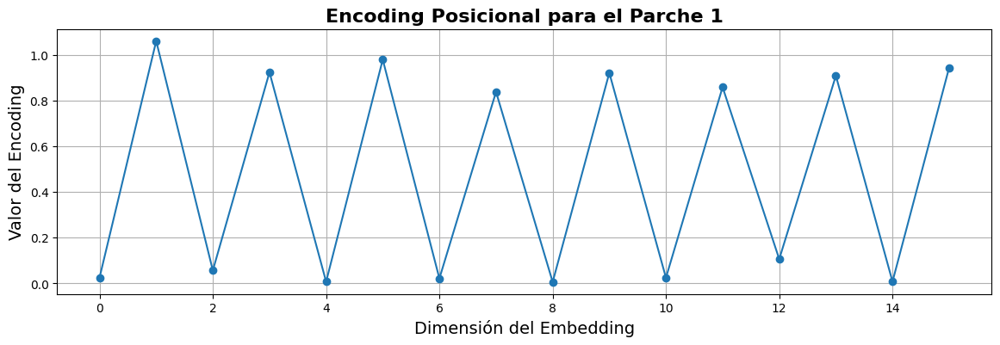

Procesando imagen con patch_size=30 y embed_dim=32
Dispositivo utilizado: cpu


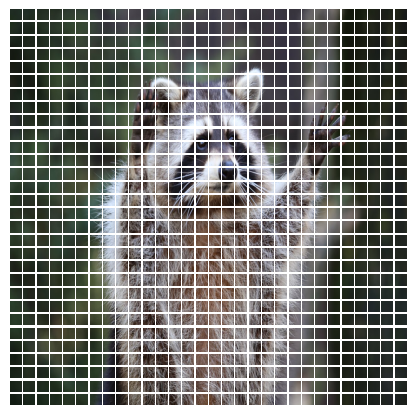

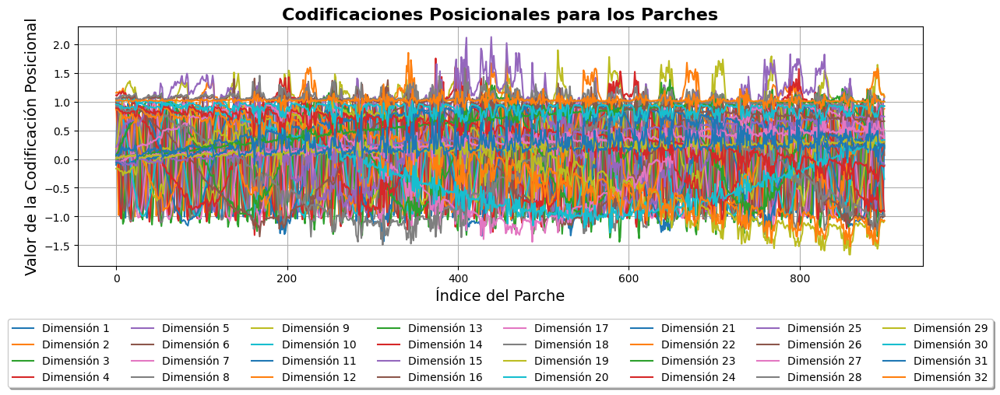

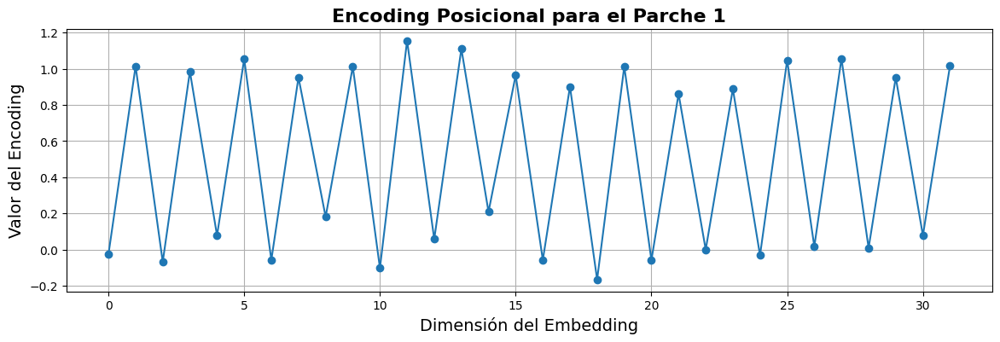

Procesando imagen con patch_size=30 y embed_dim=64
Dispositivo utilizado: cpu


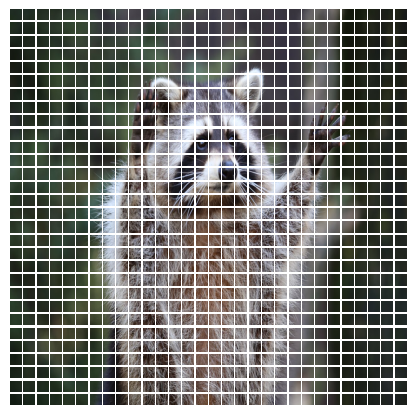

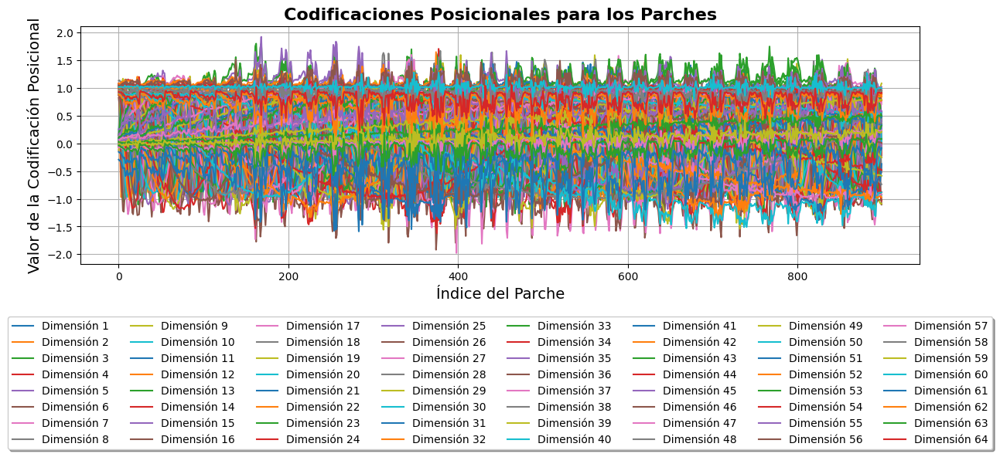

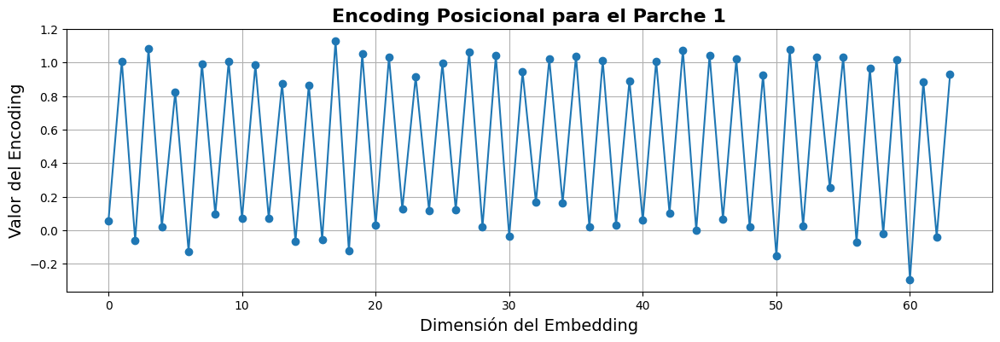

Procesando imagen con patch_size=30 y embed_dim=128
Dispositivo utilizado: cpu


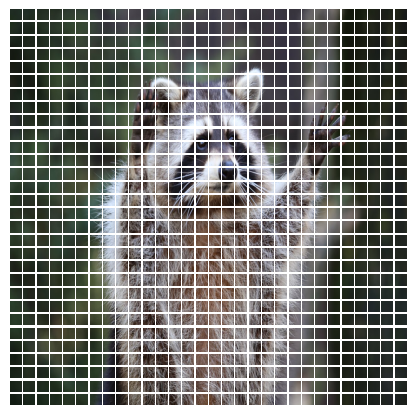

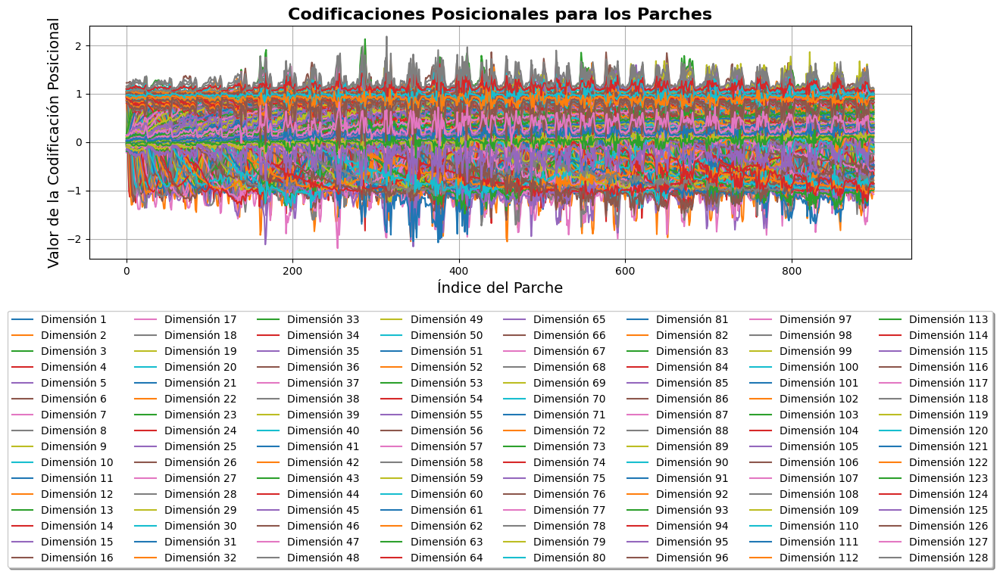

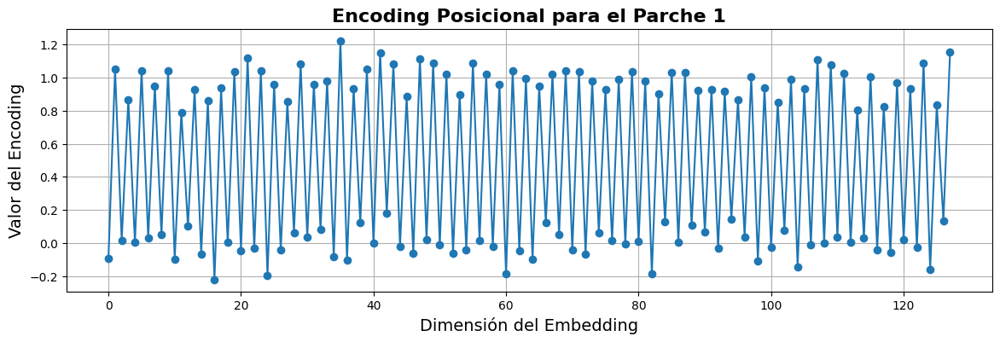

Procesando imagen con patch_size=60 y embed_dim=8
Dispositivo utilizado: cpu


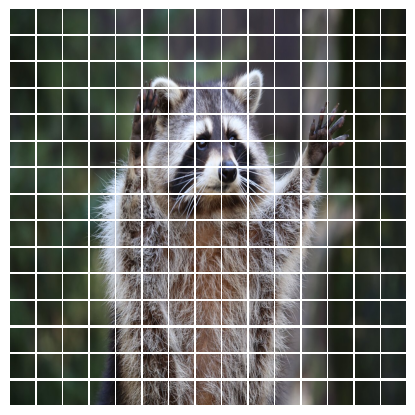

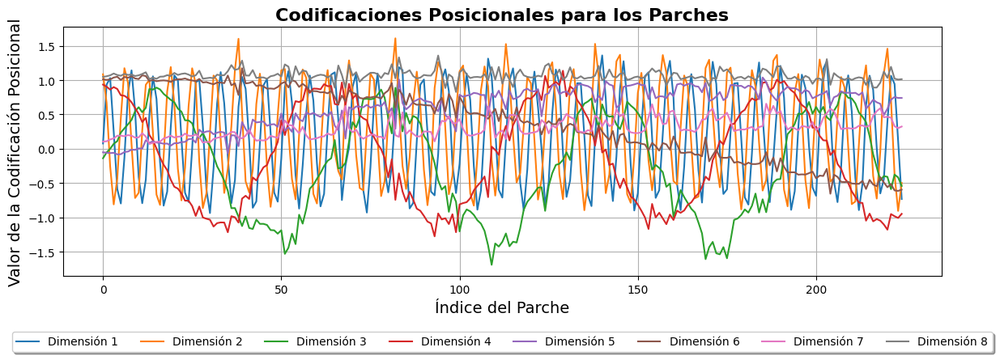

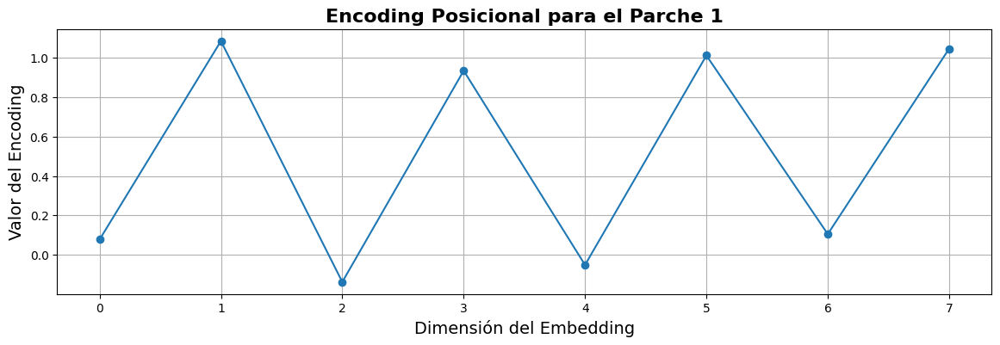

Procesando imagen con patch_size=60 y embed_dim=16
Dispositivo utilizado: cpu


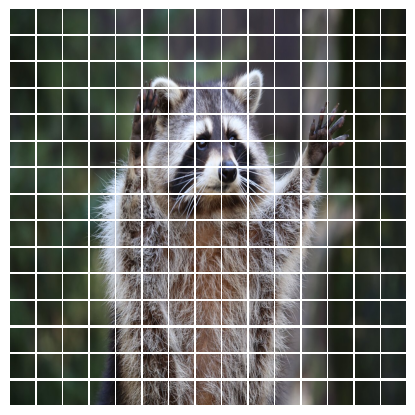

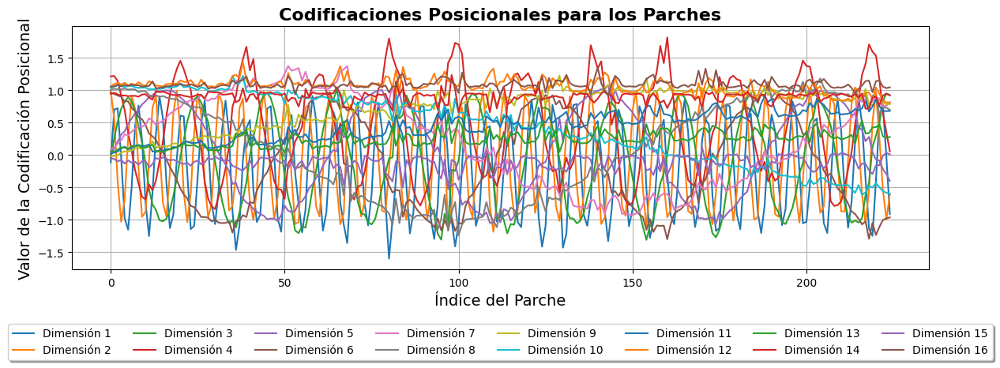

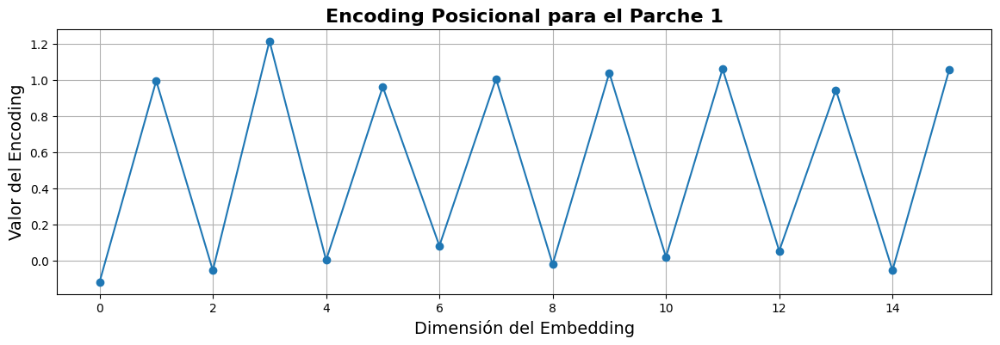

Procesando imagen con patch_size=60 y embed_dim=32
Dispositivo utilizado: cpu


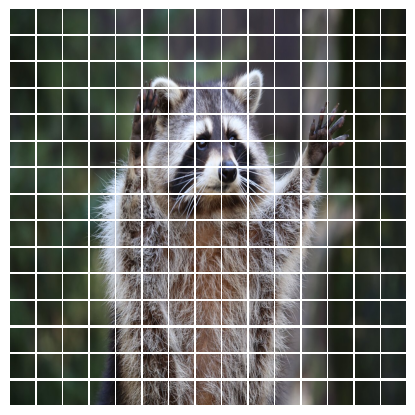

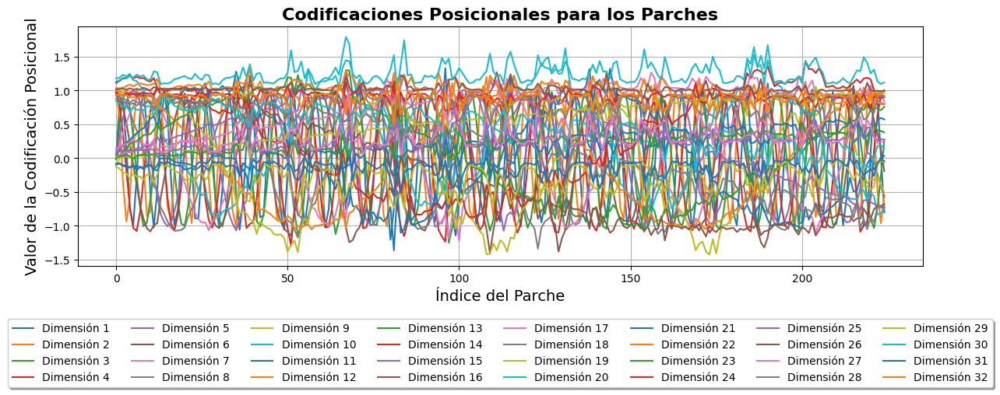

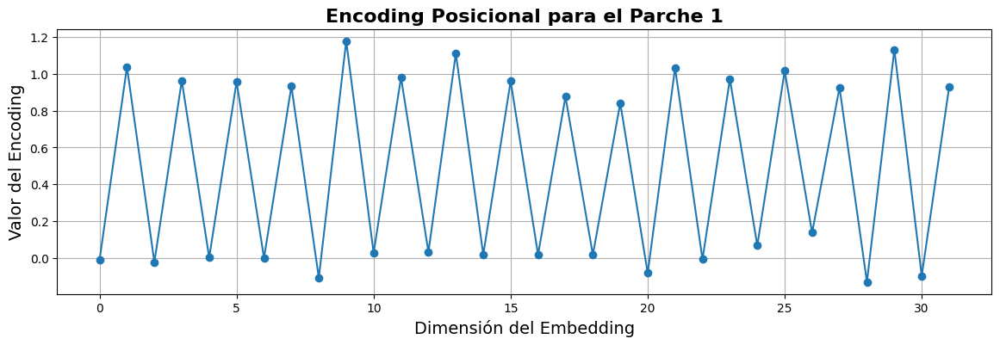

Procesando imagen con patch_size=60 y embed_dim=64
Dispositivo utilizado: cpu


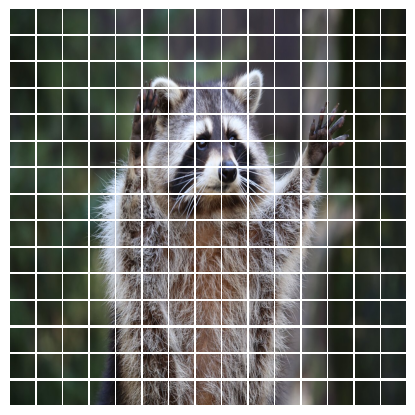

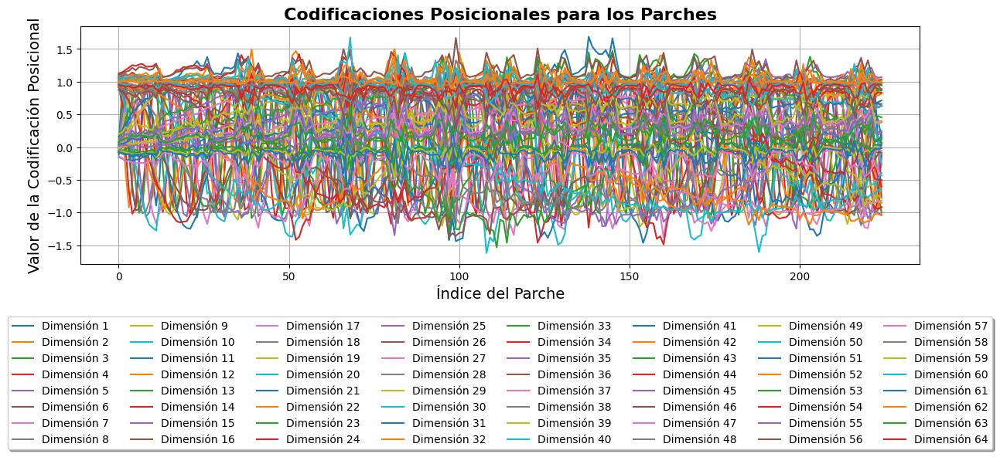

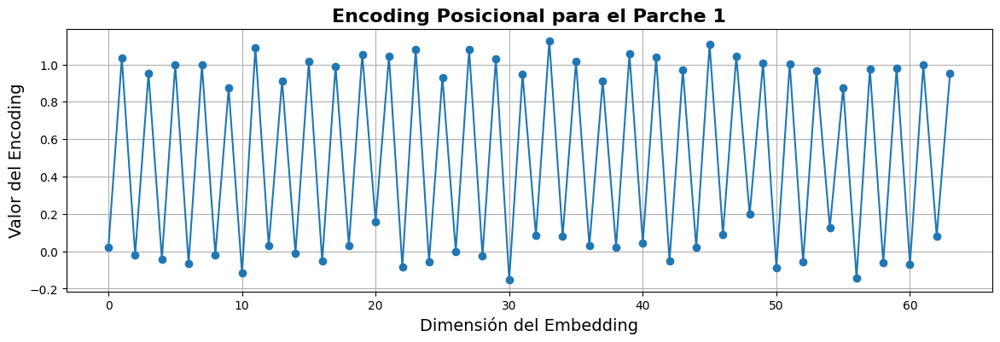

Procesando imagen con patch_size=60 y embed_dim=128
Dispositivo utilizado: cpu


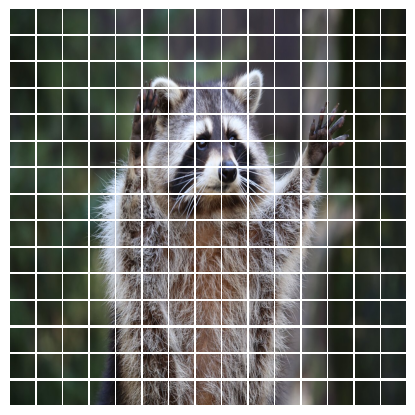

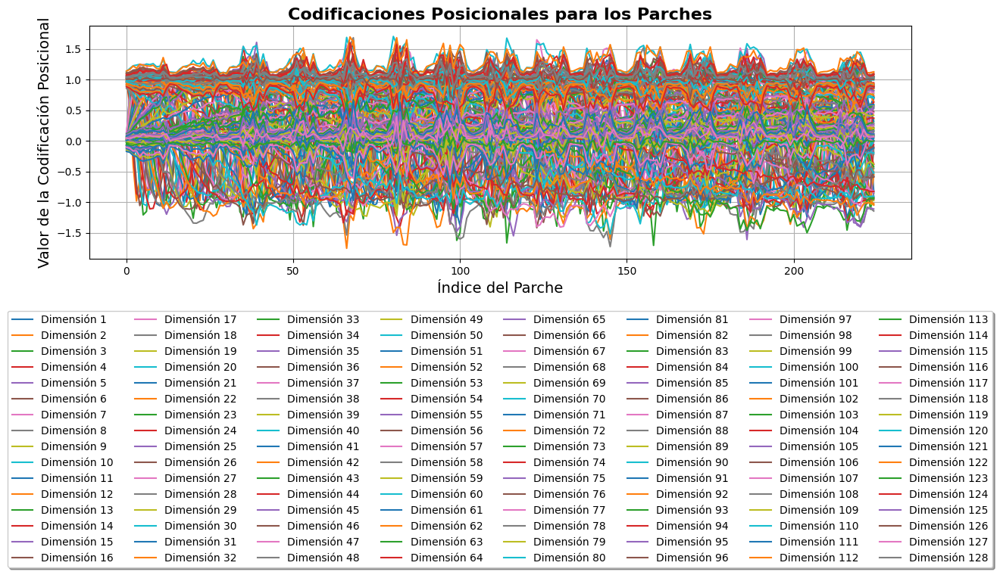

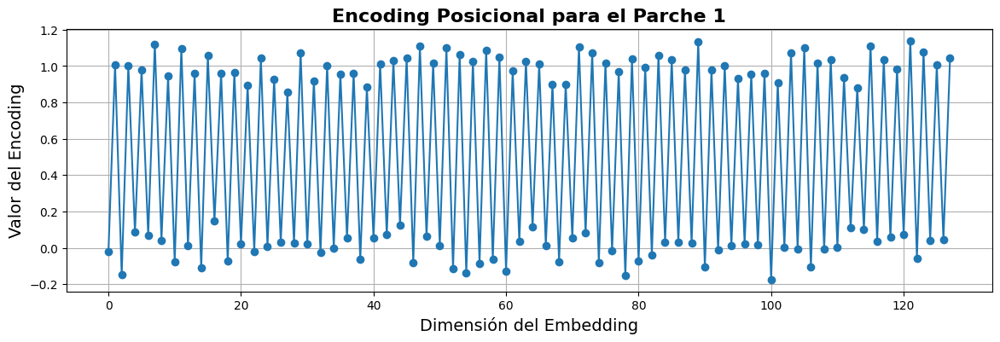

Procesando imagen con patch_size=90 y embed_dim=8
Dispositivo utilizado: cpu


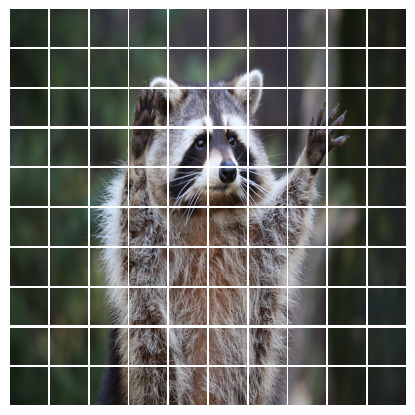

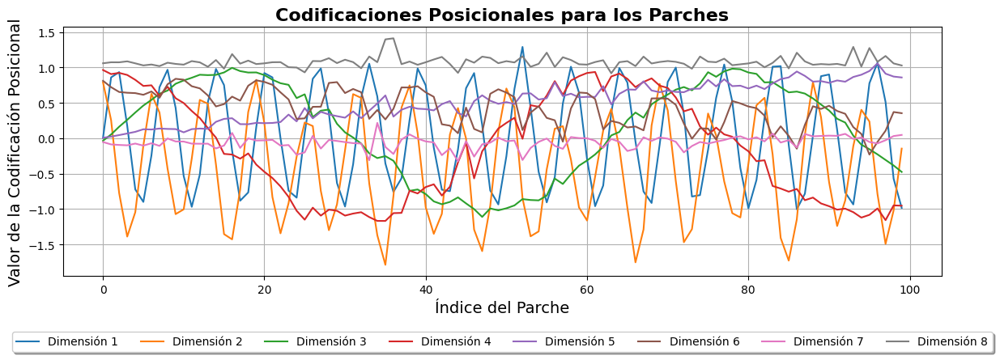

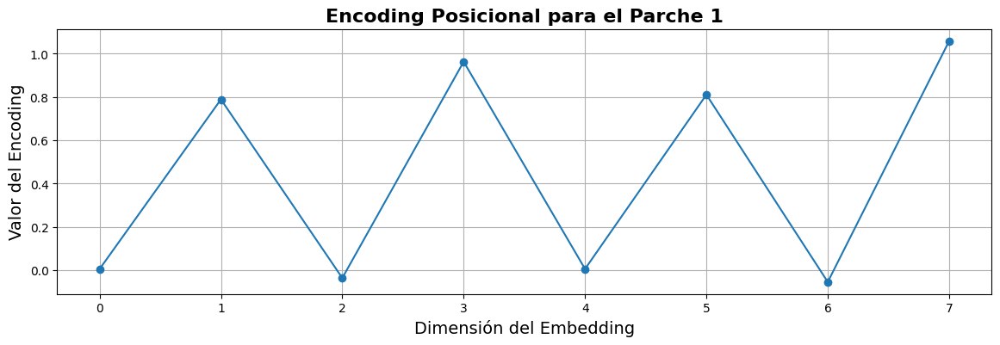

Procesando imagen con patch_size=90 y embed_dim=16
Dispositivo utilizado: cpu


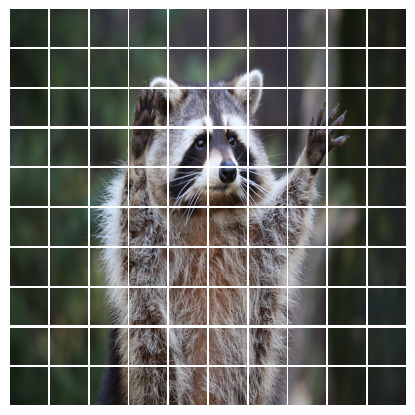

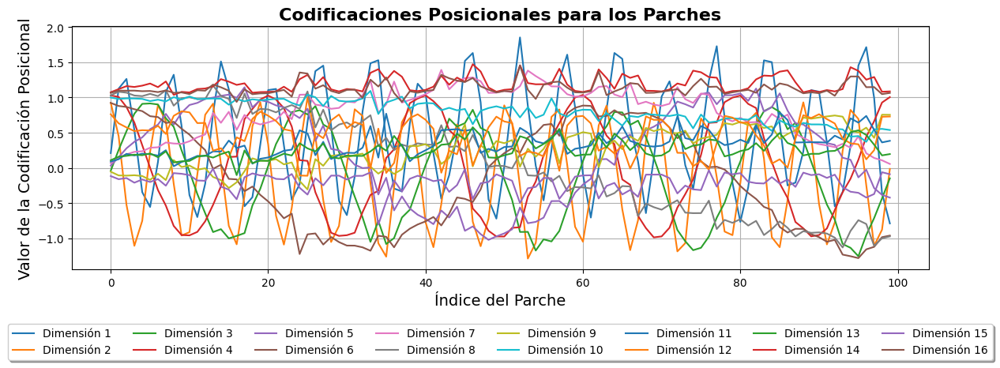

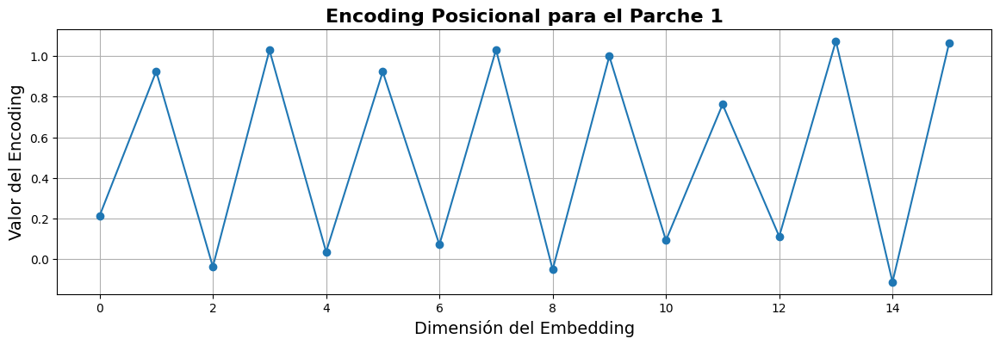

Procesando imagen con patch_size=90 y embed_dim=32
Dispositivo utilizado: cpu


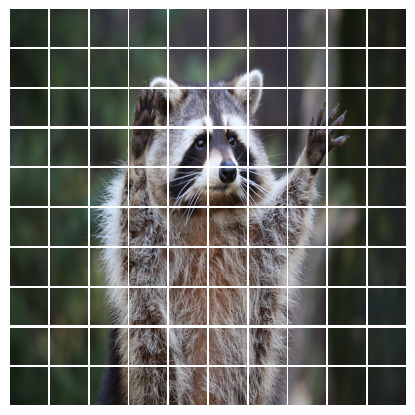

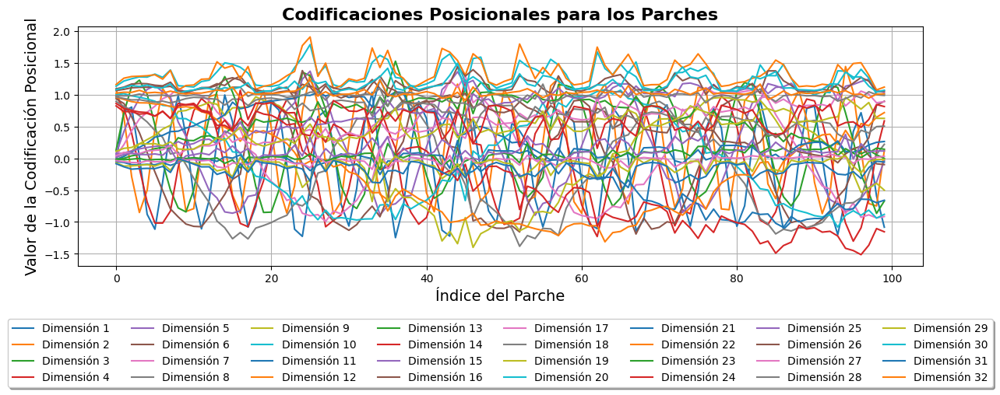

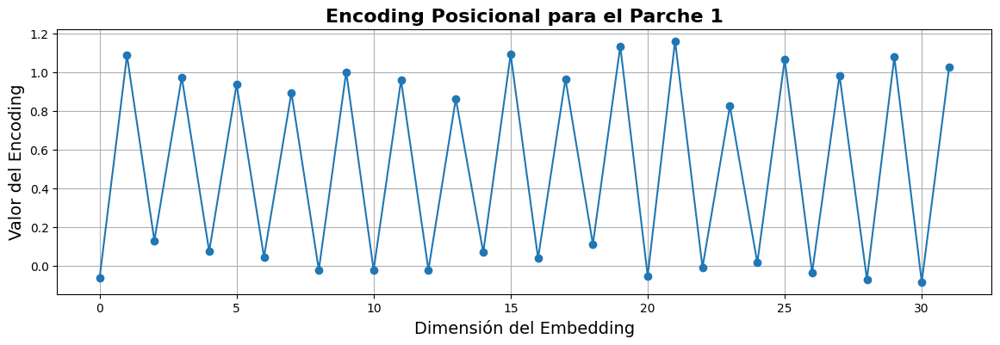

Procesando imagen con patch_size=90 y embed_dim=64
Dispositivo utilizado: cpu


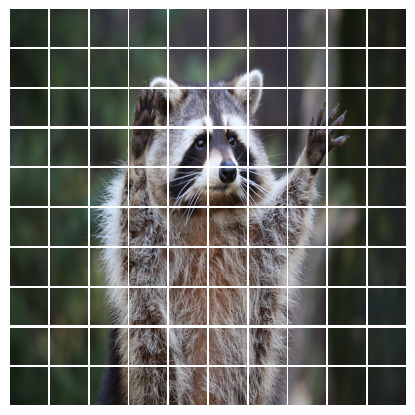

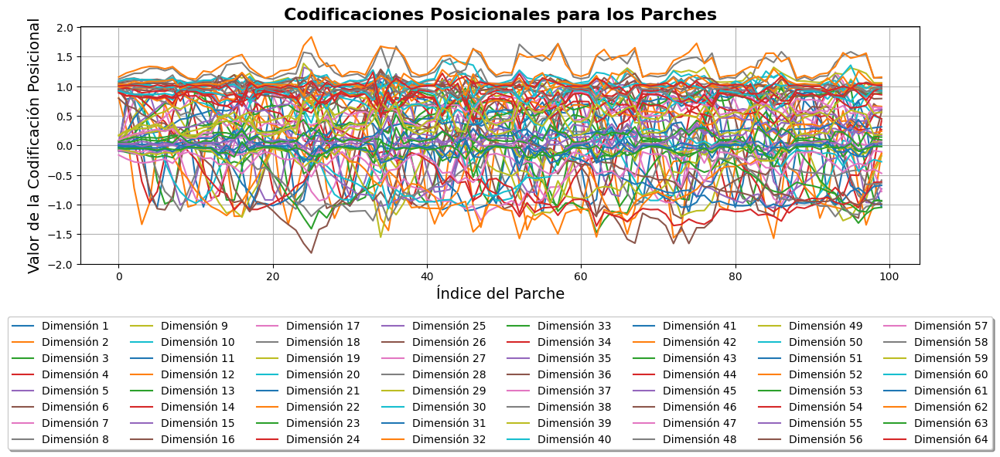

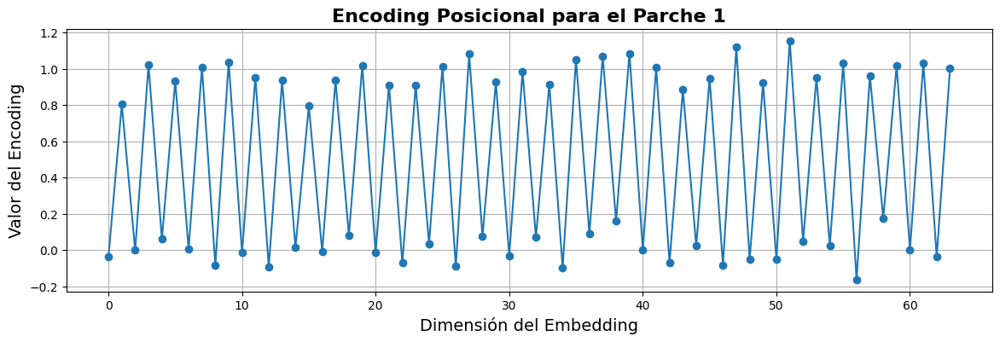

Procesando imagen con patch_size=90 y embed_dim=128
Dispositivo utilizado: cpu


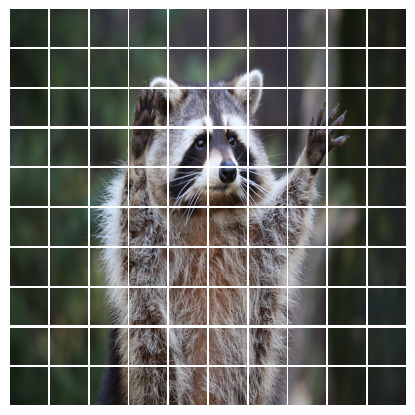

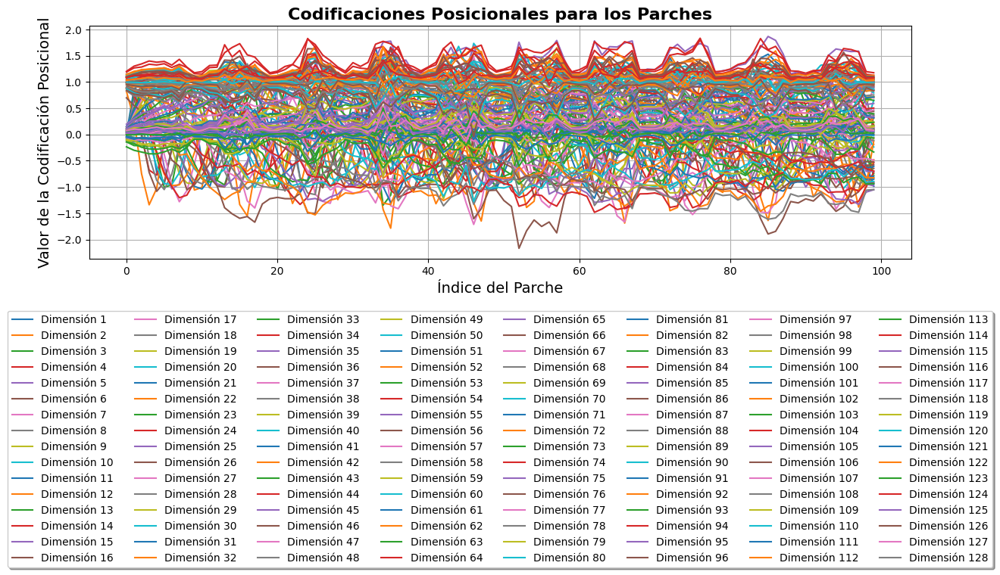

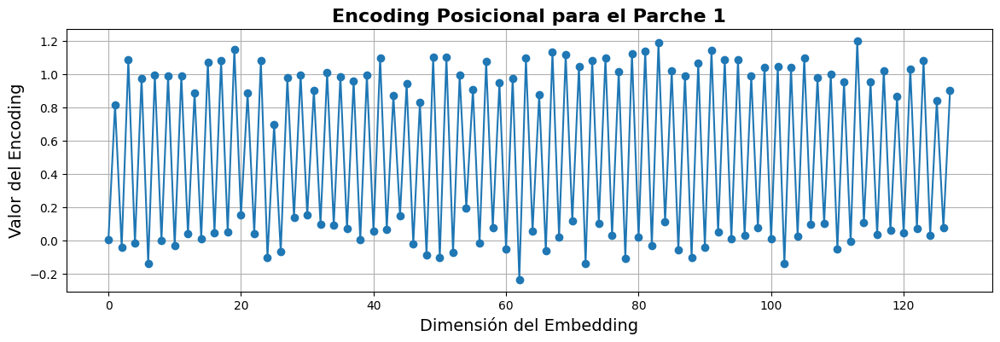

Procesando imagen con patch_size=150 y embed_dim=8
Dispositivo utilizado: cpu


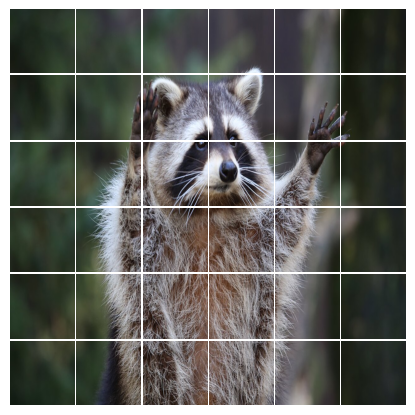

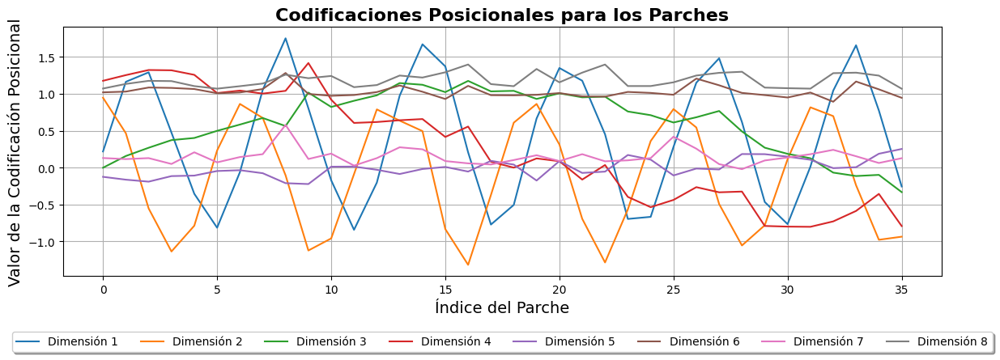

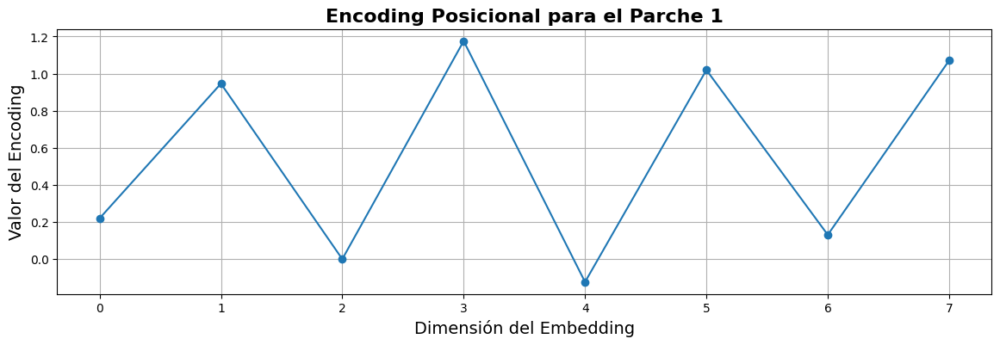

Procesando imagen con patch_size=150 y embed_dim=16
Dispositivo utilizado: cpu


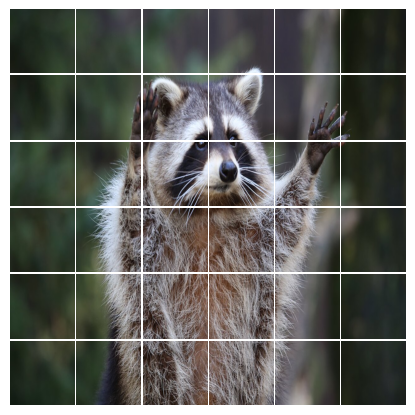

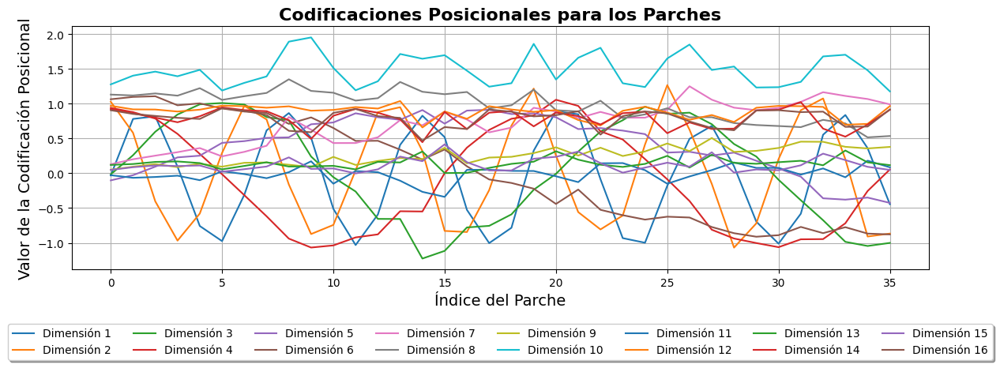

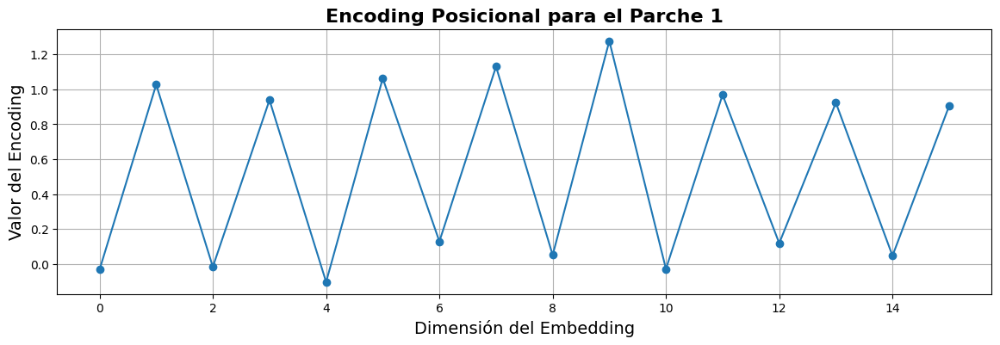

Procesando imagen con patch_size=150 y embed_dim=32
Dispositivo utilizado: cpu


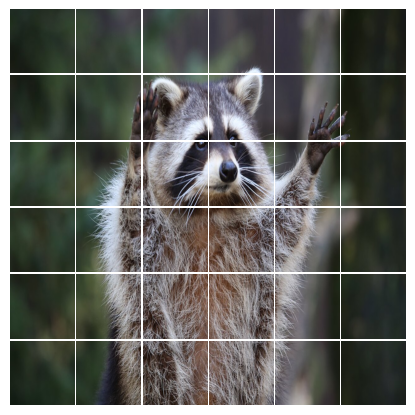

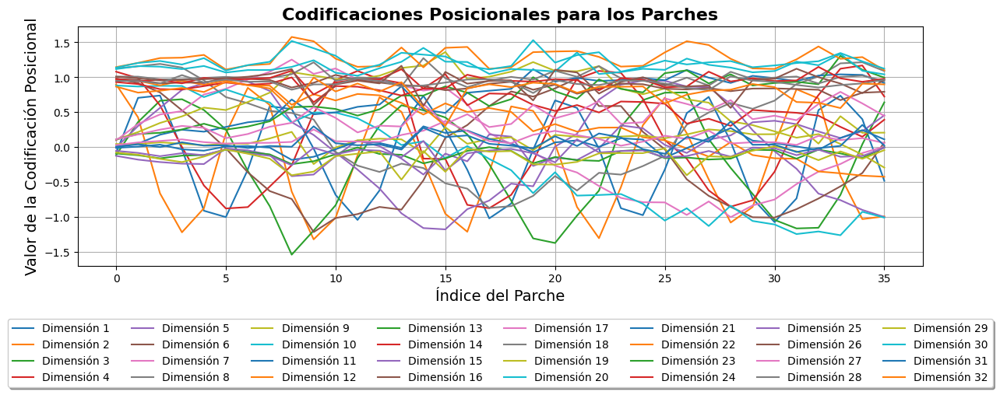

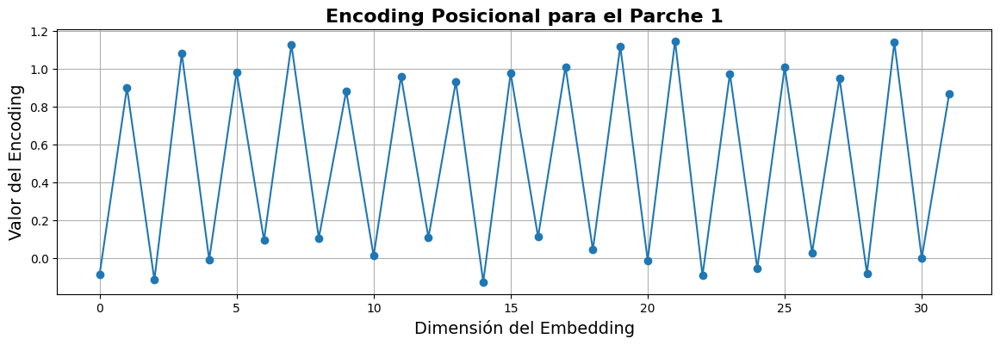

Procesando imagen con patch_size=150 y embed_dim=64
Dispositivo utilizado: cpu


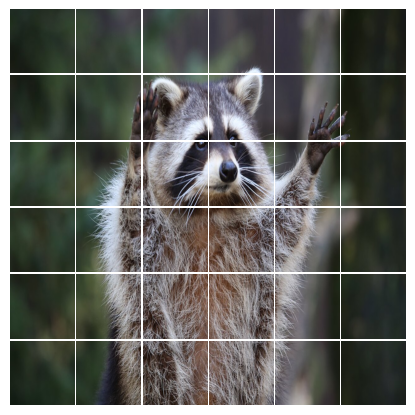

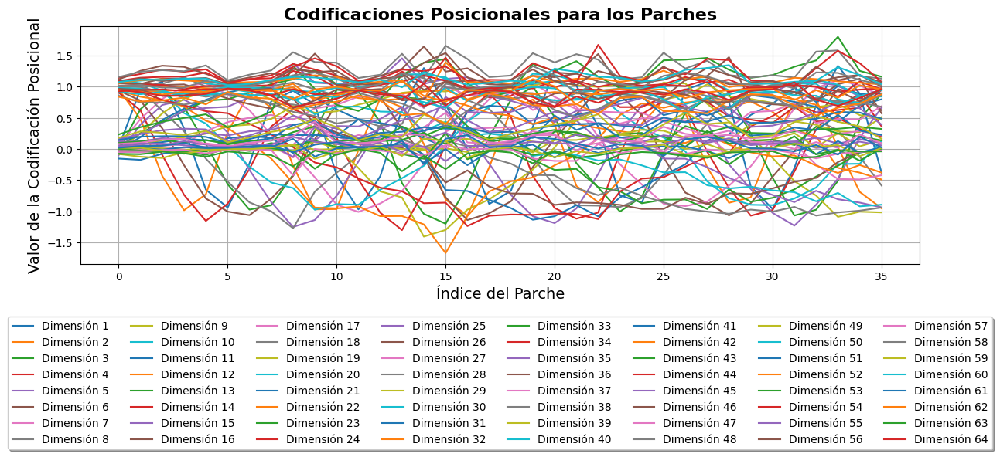

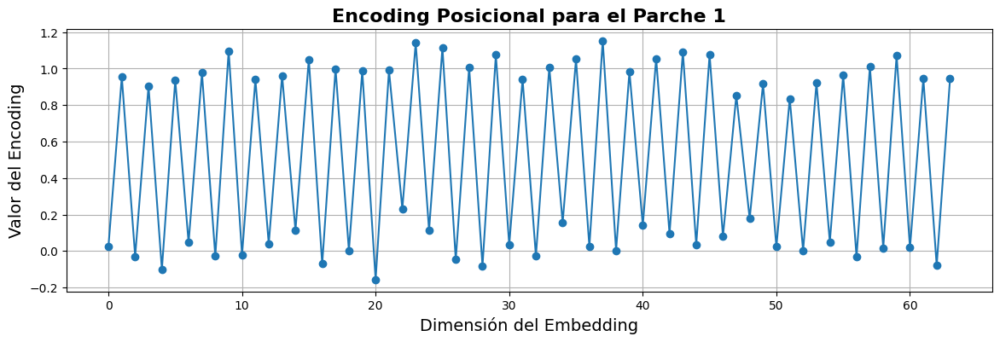

Procesando imagen con patch_size=150 y embed_dim=128
Dispositivo utilizado: cpu


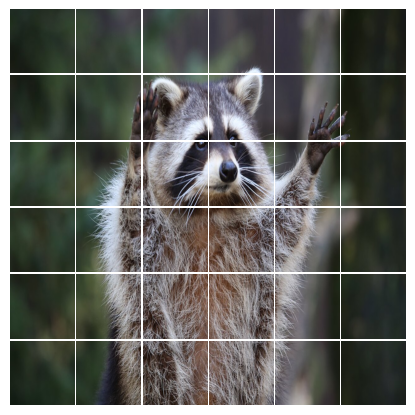

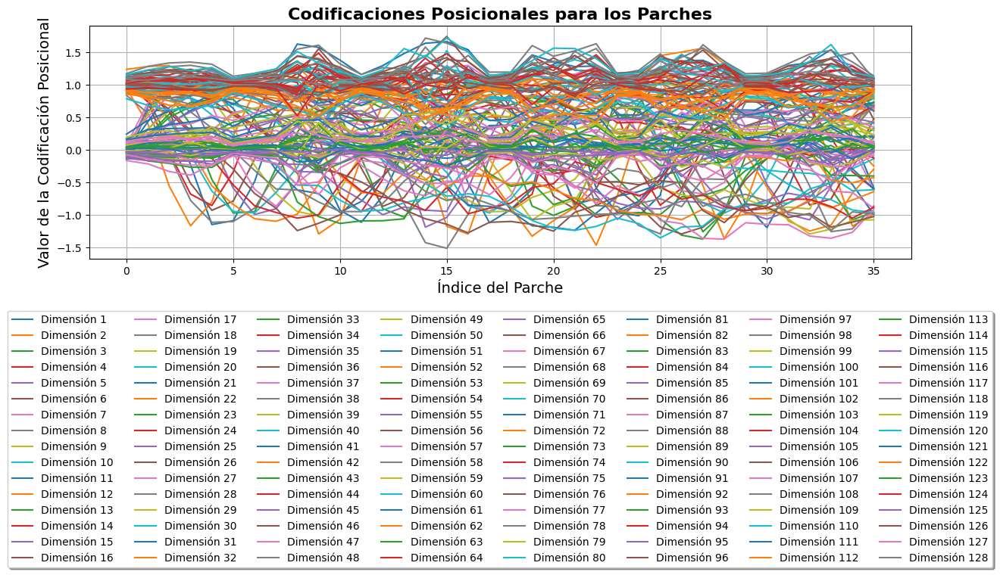

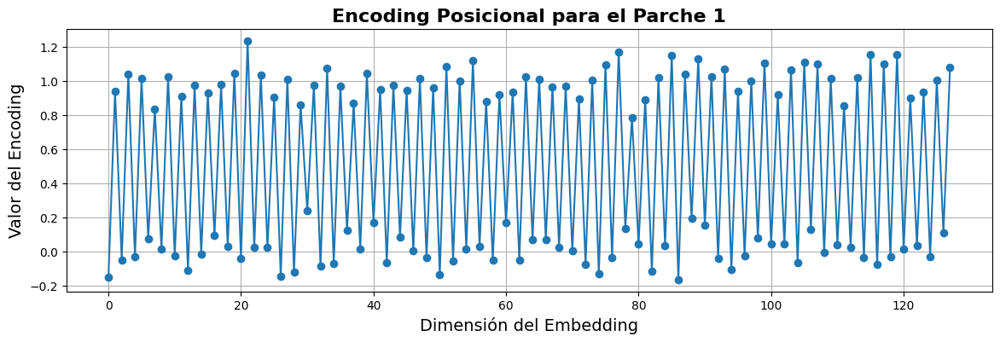

In [7]:
# Parámetros
img_path = "raccoon.jpg"
img_size = 900
patch_sizes = [30, 60, 90, 150]
embed_dims = [8, 16, 32, 64, 128]
patch_idx = 0  # El índice del parche para el cual queres visualiizar la codificación posicional

for patch_size in patch_sizes:
    for embed_dim in embed_dims:
        try:
            print(f"Procesando imagen con patch_size={patch_size} y embed_dim={embed_dim}")
            # Preprocesamiento
            config = ConfigPreprocess(img_path, img_size, patch_size)

            # Extracción de parches y visualización
            patches = config.extract_patches(config.test_img.squeeze(0))
            Visualization.visualize_patches(patches)

            # Generación de embeddings
            embedded_patches = PatchEmbedding(img_size, patch_size, 3, embed_dim).to(config.device)
            patches = embedded_patches(config.test_img)

            # Codificación posicional
            num_patches = (img_size // patch_size) ** 2
            positional_encoding = PositionalEncoding(num_patches, embed_dim).to(config.device)
            pos_embeddings = positional_encoding(patches)
            Visualization.visualize_positional_encoding(pos_embeddings)
            Visualization.visualize_single_patch_encoding(pos_embeddings, patch_idx)
            
        except Exception as e:
            print(f"Error al procesar la imagen con patch_size={patch_size} y embed_dim={embed_dim}: {e}")

**1. Cantidad de Parches**

Cuantos más parches tenga una imagen, más pequeño será cada uno. Esto permite al modelo acceder a información más localizada, facilitando la detección de detalles finos. Por lo tanto, puede ser una ventaja en tareas donde los pequeños patrones o texturas son relevantes. Sin embargo, al incrementar la cantidad de parches, también aumenta la longitud de la secuencia de entrada (es decir, más tokens), lo que eleva los requisitos de cómputo tanto en tiempo como en memoria. Además, el modelo podría requerir mayor complejidad para captar relaciones de largo alcance o estructuras globales.

Por el contrario, si la imagen se divide en menos parches, estos serán más grandes y cada uno abarcará una región más amplia. Esto puede ser beneficioso para tareas donde importa más el contexto general que los detalles locales, ya que permite al modelo tener una vista más global desde el inicio. En estos casos, se reduce considerablemente la longitud de la secuencia, lo que se traduce en una menor carga computacional. La desventaja es que se pierde resolución espacial y se pueden omitir detalles sutiles, como bordes o texturas pequeñas.

**2. Dimensiones del Embedding Posicional**

Aumentar la cantidad de dimensiones del embedding posicional incrementa su capacidad representacional: cada posición puede codificarse de forma más única y precisa. Además, permite incorporar una mayor variedad de frecuencias, lo cual mejora la discriminación entre posiciones, especialmente en secuencias largas. Esto suele favorecer el rendimiento en tareas complejas, como segmentación precisa o reconocimiento de patrones espaciales detallados.
Sin embargo, un embedding más grande implica un mayor consumo de memoria y procesamiento por token. También incrementa el riesgo de sobreajuste, sobre todo si el dataset es pequeño, ya que el modelo podría capturar ruido en lugar de información relevante.

En cambio, al reducir la cantidad de dimensiones, disminuye la carga computacional y el número de parámetros, lo cual puede ser beneficioso para tareas más simples o en contextos con pocos datos. También reduce el riesgo de overfitting. La contracara es que las codificaciones posicionales resultan menos expresivas, lo que puede generar ambigüedades entre posiciones distintas o dificultar la representación de diferencias espaciales sutiles.

En resumen:

| Cantidad de Parches  | Dimensiones del Embedding | Ventajas                                                                                                                                                 | Desventajas                                                                                                                                                      |
| ---------- | -------------- | -------------------------------------------------------------------------------------------------------------------------------------------------------- | ---------------------------------------------------------------------------------------------------------------------------------------------------------------- |
| **Muchos** | **Muchas**      | - Máximo nivel de detalle espacial y semántico. <br> - Puede capturar patrones complejos y finos. <br> - Mejor para tareas con alta variabilidad visual. | - Altísimo costo computacional. <br> - Gran riesgo de overfitting en datasets chicos/tareas muy simples. <br> - Requiere mucha memoria (GPU). |
| **Muchos** | **Pocas**      | - Alto nivel de detalle espacial sin tanto costo computacional. <br> - Mejor generalización si el dataset no es muy grande.                              | - Cada parche lleva poca información, puede no ser suficiente para representar detalles complejos. <br> - Puede perder capacidad expresiva.                      |
| **Pocos**  | **Muchas**      | - Cada parche lleva mucha información, más capacidad por token. <br> - Menor cantidad de tokens reduce el cómputo.                                       | - Se pierde resolución espacial (menos parches = menos visión localizada). <br> - Riesgo de sobrecargar cada token con demasiada información.                |
| **Pocos**  | **Pocas**      | - Modelo liviano, bajo cómputo. <br> - Menor riesgo de overfitting. <br> - Rápido para prototipos.                                                       | - Baja resolución espacial y semántica. <br> - Mala performance en tareas complejas o visualmente ricas. <br> - Puede fallar en capturar patrones importantes.   |


Nota: Si uso una imagen de baja resolución con parches muy pequeños, puedo tener aliasing (información ambigua o distorsionada). En ese caso, conviene usar parches más grandes para evitar perder patrones importantes.

### **2. Implementar embedding posicional aprendido 1D:** Partiendo de ejemplo proporcionado (codificación sinusoidal en clase PositionalEncoding), implementar una clase PositionalEncodingLearned que utilice PyTorch y genere embebidos posicionales aprendidos. Graficar. 

Se define un parámetro entrenable `nn.Parameter` que representa los embeddings posicionales y se inicializa con valores alatorios. Es un tensor de dimensiones `(1, num_patches, embed_dim)`:
- `1`: se comparte la misma codificación posicional para todos los elementos del batch. PyTorch usa broadcasting para expandirlo automáticamente al tamaño del batch real durante el entrenamiento.
- `num_patches`: cantidad de parches extraídos de la imagen (1 pos distinta para c/u).
- `embed_dim`: dimensión de cada vector del embedding. 

En el método `forward`simplemente se suma el tensor de embeddings posicionales al embedding de los parches ya generado para agregar información de posición a cada token antes de entrenar al transformer.

In [10]:
class PositionalEncodingLearned(nn.Module):
    def __init__(self, num_patches: int, embed_dim: int):
        super(PositionalEncodingLearned, self).__init__()
        self.pos_embedding = nn.Parameter(torch.randn(1, num_patches, embed_dim))

    def forward(self, x):
        return x + self.pos_embedding

Dispositivo utilizado: cpu


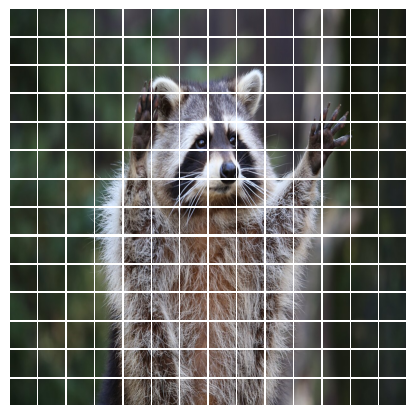

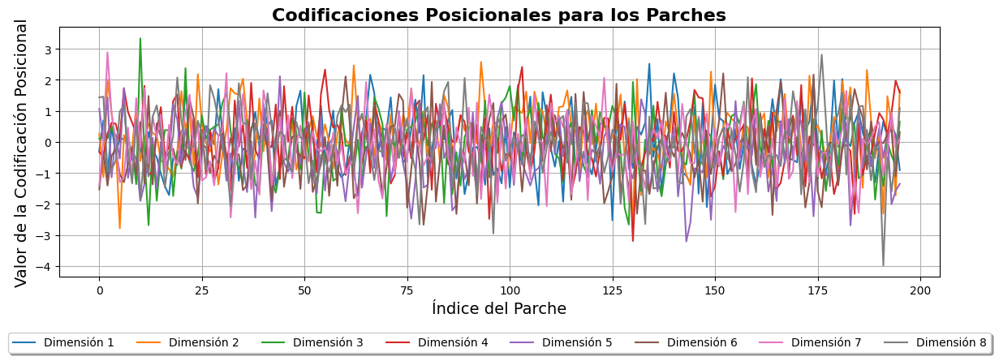

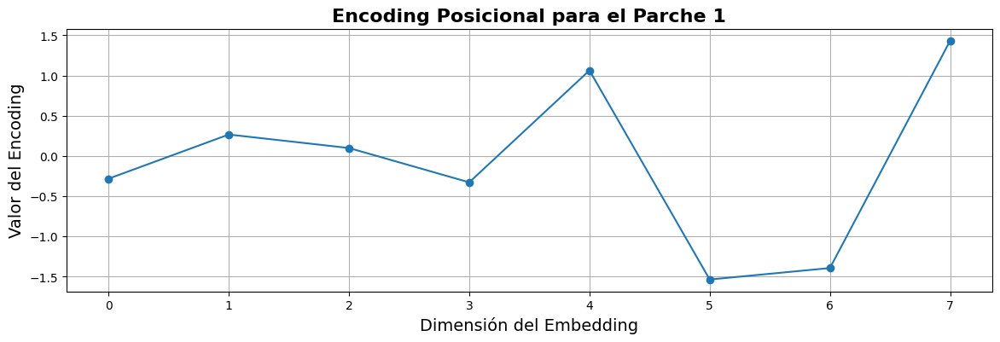

In [ ]:
# Parámetros
img_path = "raccoon.jpg"
img_size = 900
patch_size = 64
embed_dim = 8
patch_idx = 0

# Preprocesamiento
config = ConfigPreprocess(img_path, img_size, patch_size)
patches = config.extract_patches(config.test_img.squeeze(0))
Visualization.visualize_patches(patches)

# Embedding de parches
embedded_patches = PatchEmbedding(img_size, patch_size, 3, embed_dim).to(config.device)
patches = embedded_patches(config.test_img)

# Codificación posicional aprendida
num_patches = (img_size // patch_size) ** 2
pos_encoding_learned = PositionalEncodingLearned(num_patches, embed_dim).to(config.device)
pos_embeddings = pos_encoding_learned(patches)

# Visualización 
Visualization.visualize_positional_encoding(pos_embeddings)
Visualization.visualize_single_patch_encoding(pos_embeddings, patch_idx)

A diferencia de la codificación sinusoidal, estas curvas no siguen un patrón regular. Como los embeddings posicionales aprendidos comienzan con valores aleatorios, su representación inicial parece ruidosa. Sin embargo, con el proceso de aprendizaje deberían adquirir estructura y reflejar relaciones espaciales útiles, como se muestra en la Figura 7 del paper [*An Image is Worth 16x16 Words: Transformers for Image Recognition at Scale*](https://arxiv.org/abs/2010.11929), donde embeddings que comparten fila o columna desarrollan codificaciones similares.

![alt text](visualizing-positional-encodings-vit.png)

En la matriz de similitud, cada celda representa la similitud coseno entre los embeddings posicionales de dos parches. Se puede observar que los parches en la misma fila o columna tienen valores de similitud más altos, lo que sugiere que los embeddings posicionales aprendidos capturan la estructura bidimensional de la imagen.